<a href="https://colab.research.google.com/github/victor-roris/ML-learning/blob/master/ComputerVision/DeepLearning_ComputerVision_ImageClassification_Catalyst_DataSpartan_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MultiLabel Image Classification with Catalyst 

In this notebook we generate a model in pytorch to try to classify images of figure (from a **non public dataset**).

To generate the model we use the [catalyst](https://github.com/catalyst-team/catalyst) library. This code is an adaptation from the [notebook](https://colab.research.google.com/github/catalyst-team/catalyst/blob/master/examples/notebooks/classification-tutorial.ipynb) created by [Roman Tezikov](https://github.com/TezRomacH), [Sergey Kolesnikov](https://github.com/Scitator)

[![Catalyst logo](https://raw.githubusercontent.com/catalyst-team/catalyst-pics/master/pics/catalyst_logo.png)](https://github.com/catalyst-team/catalyst)

### Colab setup

First of all, do not forget to change the runtime type to GPU. <br/>
To do so click `Runtime` -> `Change runtime type` -> Select `"Python 3"` and `"GPU"` -> click `Save`. <br/>
After that you can click `Runtime` -> `Run` all and watch the tutorial.

In [1]:
from IPython.display import clear_output

import warnings
warnings.filterwarnings('ignore')

## Requirements

Download and install the latest version of catalyst and other libraries required for this tutorial.

In [2]:
# this variable will be used in `runner.train` and by default we disable FP16 mode
is_fp16_used = False
is_alchemy_used = False

In [3]:
# !pip install -U albumentations pretrainedmodels catalyst tensorflow
# clear_output()

In [4]:
# for augmentations
!pip install -U albumentations

# for pretrained models for PyTorch
!pip install pretrainedmodels


################
# Catalyst itself
!pip install -U catalyst
# For specific version of catalyst, uncomment:
# ! pip install git+http://github.com/catalyst-team/catalyst.git@{master/commit_hash}
################

# for TTA
# !pip install ttach

# for tensorboard
!pip install tensorflow
%load_ext tensorboard

# for alchemy experiment logging integration, uncomment this 2 lines below
# !pip install -U alchemy
# is_alchemy_used = True

# if Your machine support Apex FP16, uncomment this 3 lines below
# !git clone https://github.com/NVIDIA/apex
# !pip install -v --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" ./apex
# is_fp16_used = True

clear_output()

### Colab extras – Plotly

To intergate visualization library `plotly` to colab, run

In [5]:
import IPython

def configure_plotly_browser_state():
    display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))


IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

## Setting up GPUs

In [6]:
from typing import Callable, List, Tuple 

import os
import torch
import catalyst

from catalyst.dl import utils

print(f"torch: {torch.__version__}, catalyst: {catalyst.__version__}")

# os.environ["CUDA_VISIBLE_DEVICES"] = "0"  # "" - CPU, "0" - 1 GPU, "0,1" - MultiGPU

SEED = 42
utils.set_global_seed(SEED)
utils.prepare_cudnn(deterministic=True)

torch: 1.6.0+cu101, catalyst: 20.07


# Reproducibility

[![Alchemy logo](https://raw.githubusercontent.com/catalyst-team/catalyst-pics/master/pics/alchemy_logo.png)](https://github.com/catalyst-team/alchemy)

To make your research more reproducible and easy to monitor, Catalyst has an integration with [Alchemy](https://alchemy.host) – experiment tracking tool for deep learning.

To use monitoring, goto [Alchemy](https://alchemy.host/) and get your personal token.

In [7]:
# for alchemy experiment logging integration, uncomment this 2 lines below
# !pip install -U alchemy
# is_alchemy_used = True

In [8]:
if is_alchemy_used:
    monitoring_params = {
        "token": None, # insert your personal token here
        "project": "classification_example",
        "group": "first_trials",
        "experiment": "first_experiment",
    }
    assert monitoring_params["token"] is not None
else:
    monitoring_params = None

-------

## Dataset

### Download data

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [10]:
# !wget https://www.dropbox.com/s/lsgwz1ydbdwmqzn/DSFigureDataset.tar.gz?dl=0  -O DSFigureDataset.tar.gz
# clear_output()

In [11]:
dataset_folderpath = "/content/input"

In [12]:
import os
if os.path.isdir(dataset_folderpath):
  !rm -R {dataset_folderpath}

In [13]:
from pathlib import Path
def mkdir(sfolderpath):
  folderpath = Path(sfolderpath)
  folderpath.mkdir(parents=True, exist_ok=True)

mkdir(dataset_folderpath)

In [14]:
!tar -xvf /content/drive/My\ Drive/DATASPARTAN/PROYECTOS/AI-DOCUMENTS/SEGMENTATION/DSFigureDataset.tar.gz -C {dataset_folderpath}
# !tar -xvf ./DSFigureDataset.tar.gz -C {dataset_folderpath}

clear_output()

!ls {dataset_folderpath}

raw  setup.py


Clean the images that can't be processed by the library. 
[Issue link](https://github.com/catalyst-team/catalyst/issues/751)

In [15]:
from catalyst import utils

img_paths = list(Path(os.path.join(dataset_folderpath,"raw")).glob("**/*.*"))

print(f"Number of files before clean: {len(img_paths)}")
for img_path in img_paths:
  try:
    utils.imread(img_path)
  except:
    os.remove(img_path)    

img_paths = list(Path(os.path.join(dataset_folderpath,"raw")).glob("**/*.*"))
print(f"Number of files after clean: {len(img_paths)}")

Number of files before clean: 5296
Number of files after clean: 5296


### Split `train`, `val` and `test` dataset

The `zip` contains a script to generate the ml dataset

In [16]:
% cd {dataset_folderpath}
!python setup.py

%cd /content/

/content/input
Number of classes : 21
['FlowChart', 'PersonPhoto', 'HorizontalBarGraph', 'BubbleChart', 'TreeDiagram', 'Logo', 'VerticalBarGraph', 'NetworkDiagram', 'AreaGraph', 'PieChart', 'ScatterGraph', 'Signatures', 'BoxPlot', 'Map', 'GeneralPhoto', 'RadarPlot', 'ParetoChart', 'VennDiagram', 'GeneralFigure', 'Table', 'LineGraph']
FlowChart: 
   > ntrain : 204
   > nval : 85
   > ntest : 3

PersonPhoto: 
   > ntrain : 160
   > nval : 66
   > ntest : 3

HorizontalBarGraph: 
   > ntrain : 149
   > nval : 61
   > ntest : 3

BubbleChart: 
   > ntrain : 170
   > nval : 70
   > ntest : 3

TreeDiagram: 
   > ntrain : 164
   > nval : 68
   > ntest : 3

Logo: 
   > ntrain : 170
   > nval : 70
   > ntest : 3

VerticalBarGraph: 
   > ntrain : 251
   > nval : 105
   > ntest : 4

NetworkDiagram: 
   > ntrain : 183
   > nval : 76
   > ntest : 3

AreaGraph: 
   > ntrain : 157
   > nval : 65
   > ntest : 3

PieChart: 
   > ntrain : 166
   > nval : 69
   > ntest : 3

ScatterGraph: 
   > ntrain : 146

In [17]:
input_folder = "/content/input/dataset"

trn_folder = os.path.join(input_folder,"train")
val_folder = os.path.join(input_folder,"val")
test_folder = os.path.join(input_folder,"test")

In [18]:
classes = [name for name in os.listdir(trn_folder) 
      if os.path.isdir(os.path.join(trn_folder,name))]
print(f"Number of classes : {len(classes)}")
print(classes)

Number of classes : 21
['FlowChart', 'PersonPhoto', 'HorizontalBarGraph', 'BubbleChart', 'TreeDiagram', 'Logo', 'VerticalBarGraph', 'NetworkDiagram', 'AreaGraph', 'PieChart', 'ScatterGraph', 'Signatures', 'BoxPlot', 'Map', 'GeneralPhoto', 'RadarPlot', 'ParetoChart', 'VennDiagram', 'GeneralFigure', 'Table', 'LineGraph']


### Visualize data

In [19]:
from pathlib import Path

ROOT = trn_folder
ALL_IMAGES = list(Path(ROOT).glob("**/*.*"))
ALL_IMAGES = list(filter(lambda x: not x.name.startswith("."), ALL_IMAGES))
print("Number of images:", len(ALL_IMAGES))

Number of images: 3699


Let's check out the data!

In [20]:
from catalyst.utils import imread
import numpy as np

import matplotlib.pyplot as plt

def show_examples(images: List[Tuple[str, np.ndarray]]):
    _indexes = [(i, j) for i in range(2) for j in range(2)]
    
    f, ax = plt.subplots(2, 2, figsize=(8, 8))
    for (i, j), (title, img) in zip(_indexes, images):
        ax[i, j].imshow(img)
        ax[i, j].set_title(title)
    f.tight_layout()

def read_random_images(paths: List[Path]) -> List[Tuple[str, np.ndarray]]:
    data = np.random.choice(paths, size=4)
    result = []
    for d in data:
        title = f"{d.parent.name}: {d.name}"
        _image = imread(d)
        result.append((title, _image))
    
    return result

You can restart the cell below to see more examples.

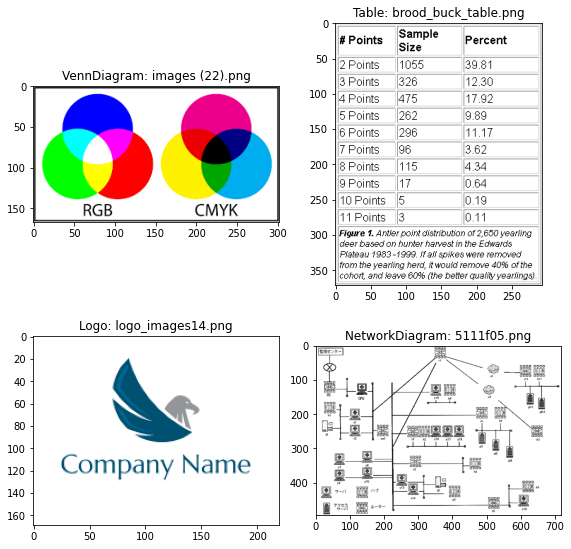

In [21]:
images = read_random_images(ALL_IMAGES)
show_examples(images)

## Dataset preprocessing

With Catalyst we can easily create a dataset from the following folder structure:
```
dataset/
    class_1/
        *.ext
        ...
    class_2/
        *.ext
        ...
    ...
    class_N/
        *.ext
        ...
```

First of all `create_dataset` function goes through a given directory and creates a dictionary `Dict[class_name, List[image]]`. <br/>
Then `create_dataframe` function creates typical `pandas.DataFrame` for further analysis. <br/>
After than `prepare_dataset_labeling` creates a numerical label for each unique class name. <br/>
Finally, to add a column with a numerical label value to the DataFrame, we can use `map_dataframe` function.

Additionaly let's save the `class_names` for further usage.

In [22]:
from catalyst.utils import (
    create_dataset, create_dataframe, get_dataset_labeling, map_dataframe
)

def get_dataset_df(dataset_folderpath):

  dataset = create_dataset(dirs=f"{dataset_folderpath}/*", extension="*.*")
  df = create_dataframe(dataset, columns=["class", "filepath"])

  tag_to_label = get_dataset_labeling(df, "class")
  class_names = [
      name for name, id_ in sorted(tag_to_label.items(), key=lambda x: x[1])
  ]

  df_with_labels = map_dataframe(
      df, 
      tag_column="class", 
      class_column="label", 
      tag2class=tag_to_label, 
      verbose=False
  )
  return df_with_labels.sample(frac=1).reset_index(drop=True)


In [23]:
train_data = get_dataset_df(trn_folder)
print(len(train_data))
train_data.head()

3699


,class,filepath,label
0,Map,/content/input/dataset/train/Map/images (10).jpeg,9
1,TreeDiagram,/content/input/dataset/train/TreeDiagram/47954...,18
2,PersonPhoto,/content/input/dataset/train/PersonPhoto/04e6c...,12
3,RadarPlot,/content/input/dataset/train/RadarPlot/maxresd...,14
4,Signatures,/content/input/dataset/train/Signatures/Joseph...,16


In [24]:
valid_data = get_dataset_df(val_folder)
print(len(valid_data))
valid_data.head()

1532


,class,filepath,label
0,Signatures,/content/input/dataset/val/Signatures/kisspng-...,16
1,TreeDiagram,/content/input/dataset/val/TreeDiagram/images ...,18
2,VerticalBarGraph,/content/input/dataset/val/VerticalBarGraph/im...,20
3,Logo,/content/input/dataset/val/Logo/logo_jbb-ba-dy...,8
4,BubbleChart,/content/input/dataset/val/BubbleChart/motion-...,2


Get the class-label map

In [25]:
import pandas as pd
label_map = pd.DataFrame(train_data,columns=['class','label'])
label_map = label_map.drop_duplicates()
label_map = label_map.sort_values(by=['label'])
label_map = label_map.reset_index(drop=True)

class_names = label_map["class"].values

print(class_names)
label_map.head()

['AreaGraph' 'BoxPlot' 'BubbleChart' 'FlowChart' 'GeneralFigure'
 'GeneralPhoto' 'HorizontalBarGraph' 'LineGraph' 'Logo' 'Map'
 'NetworkDiagram' 'ParetoChart' 'PersonPhoto' 'PieChart' 'RadarPlot'
 'ScatterGraph' 'Signatures' 'Table' 'TreeDiagram' 'VennDiagram'
 'VerticalBarGraph']


,class,label
0,AreaGraph,0
1,BoxPlot,1
2,BubbleChart,2
3,FlowChart,3
4,GeneralFigure,4


Convert `train` and `val` dataframe to dict

In [26]:
train_data, valid_data = (
    train_data.to_dict('records'), valid_data.to_dict('records')
)

In order to save your time during data preparation/reading/writing, Catalyst provides a special abstraction – [Reader](https://catalyst-team.github.io/catalyst/api/data.html#reader). <br/> 
Reader allows you to read various structures, for example, images, strings, numerical values and perform some functions on top of them.

In [27]:
from catalyst.contrib.data.cv import ImageReader
from catalyst.dl import utils
from catalyst.data import ScalarReader, ReaderCompose

num_classes = len(label_map)

# ReaderCompose collects different Readers into one pipeline
open_fn = ReaderCompose([
    
    # Reads images from the `rootpath` folder 
    # using the key `input_key =" filepath "` (here should be the filename)
    # and writes it to the output dictionary by `output_key="features"` key
    ImageReader(
        input_key="filepath",
        output_key="features",
        rootpath=None # If the image filepath is relative it should be have the root path
                      ## (but I define train and val root path separately ==>
                      ## you should define open_fn to train and other to val) 
    ),
    
    # Reads a number from our dataframe 
    # by the key `input_key =" label "` to np.long
    # and writes it to the output dictionary by `output_key="targets"` key
    ScalarReader(
        input_key="label",
        output_key="targets",
        default_value=-1,
        dtype=np.int64
    ),
    
    # Same as above, but with one encoding
    ScalarReader(
        input_key="label",
        output_key="targets_one_hot",
        default_value=-1,
        dtype=np.int64, 
        one_hot_classes=num_classes
    )
])

-------

## Augmentations

[![Albumentation logo](https://albumentations.readthedocs.io/en/latest/_static/logo.png)](https://github.com/albu/albumentations)

The [albumentation](https://github.com/albu/albumentations) library works with images and masks at the same time, which is what we need.

In [28]:
import albumentations as albu
from albumentations.pytorch import ToTensor

BORDER_CONSTANT = 0
BORDER_REFLECT = 2

def pre_transforms(image_size=224):
    # Convert the image to a square of size image_size x image_size
    # (keeping aspect ratio)
    result = [
        albu.LongestMaxSize(max_size=image_size),
        albu.PadIfNeeded(image_size, image_size, border_mode=BORDER_CONSTANT)
    ]
    
    return result

def hard_transforms():
    result = [
        # Random shifts, stretches and turns with a 50% probability
        albu.ShiftScaleRotate( 
            shift_limit=0.1,
            scale_limit=0.1,
            rotate_limit=15,
            border_mode=BORDER_REFLECT,
            p=0.5
        ),
        albu.IAAPerspective(scale=(0.02, 0.05), p=0.3),
        # Random brightness / contrast with a 30% probability
        albu.RandomBrightnessContrast(
            brightness_limit=0.2, contrast_limit=0.2, p=0.3
        ),
        # Random gamma changes with a 30% probability
        albu.RandomGamma(gamma_limit=(85, 115), p=0.3),
        # Randomly changes the hue, saturation, and color value of the input image
        albu.HueSaturationValue(p=0.3),
        albu.JpegCompression(quality_lower=80),
    ]
    
    return result

def post_transforms():
    # we use ImageNet image normalization
    # and convert it to torch.Tensor
    return [albu.Normalize(), ToTensor()]

def compose(transforms_to_compose):
    # combine all augmentations into one single pipeline
    result = albu.Compose([
      item for sublist in transforms_to_compose for item in sublist
    ])
    return result

Like Reader, there is a close abstraction for handling augmentations and key-value-based dataloaders – [Augmentor](https://catalyst-team.github.io/catalyst/api/data.html#augmentor).

In [29]:
from catalyst.data import Augmentor


train_transforms = compose([
    pre_transforms(), 
    hard_transforms(), 
    post_transforms()
])
valid_transforms = compose([pre_transforms(), post_transforms()])

show_transforms = compose([pre_transforms(), hard_transforms()])

# Takes an image from the input dictionary by the key `dict_key` 
# and performs `train_transforms` on it.
train_data_transforms = Augmentor(
    dict_key="features",
    augment_fn=lambda x: train_transforms(image=x)["image"]
)


# Similarly for the validation part of the dataset. 
# we only perform squaring, normalization and ToTensor
valid_data_transforms = Augmentor(
    dict_key="features",
    augment_fn=lambda x: valid_transforms(image=x)["image"]
)

Let's look at the augmented results. <br/>
You can restart the cell below to see more examples of augmentations.

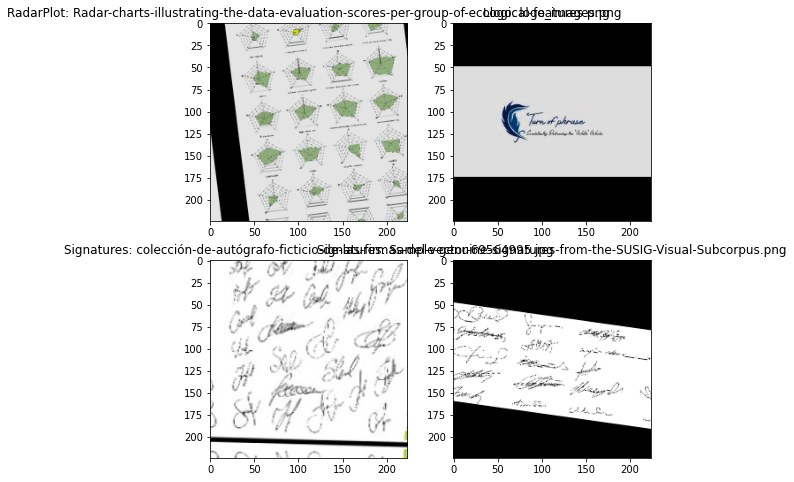

In [30]:
images = read_random_images(ALL_IMAGES)

images = [
    (title, show_transforms(image=i)["image"])
    for (title, i) in images
]
show_examples(images)

-------

## Loaders

Using `catalyst.utils.get_loader`, you can immediately get loaders only from the dataset and data-converting functions.

In [31]:
import collections

def get_loaders(
    open_fn: Callable,
    train_transforms_fn,
    valid_transforms_fn,
    batch_size: int = 64, 
    num_workers: int = 4,
    sampler = None
) -> collections.OrderedDict:
    """
    Args:
        open_fn: Reader for reading data from a dataframe
        train_transforms_fn: Augmentor for train part
        valid_transforms_fn: Augmentor for valid part
        batch_size: batch size
        num_workers: How many subprocesses to use to load data,
        sampler: An object of the torch.utils.data.Sampler class 
            for the dataset data sampling strategy specification
    """
    train_loader = utils.get_loader(
        train_data,
        open_fn=open_fn,
        dict_transform=train_transforms_fn,
        batch_size=batch_size,
        num_workers=num_workers,
        shuffle=sampler is None, # shuffle data only if Sampler is not specified (PyTorch requirement)
        sampler=sampler,
        drop_last=True,
    )

    valid_loader = utils.get_loader(
        valid_data,
        open_fn=open_fn,
        dict_transform=valid_transforms_fn,
        batch_size=batch_size,
        num_workers=num_workers,
        shuffle=False, 
        sampler=None,
        drop_last=True,
    )

    # Catalyst expects an ordered dictionary with train/valid/infer loaders. 
    # The number of loaders can vary.
    # For example, it can easily handle even some complex logic like:
    # loaders["train_dataset1"] = train_loader_1
    # loaders["train_dataset2"] = train_loader_2
    # ....
    # loaders["valid_1"] = valid_loader_1
    # loaders["valid_2"] = valid_loader_2
    # ...
    # loaders["infer_1"] = infer_loader_1
    # loaders["infer_2"] = infer_loader_2
    # ...
    
    loaders = collections.OrderedDict()
    loaders["train"] = train_loader
    loaders["valid"] = valid_loader

    return loaders

if is_fp16_used:
    batch_size = 128
else:
    batch_size = 64

print(f"batch_size: {batch_size}")

loaders = get_loaders(
    open_fn=open_fn, 
    train_transforms_fn=train_data_transforms,
    valid_transforms_fn=valid_data_transforms,
    batch_size=batch_size,
)


batch_size: 64


-------

## Experiment
### Model

Let's take the classification model from [Cadene pretrain models](https://github.com/Cadene/pretrained-models.pytorch). This repository contains a huge number of pre-trained PyTorch models.

In [32]:
from torch import nn
import pretrainedmodels


def get_model(model_name: str, num_classes: int, pretrained: str = "imagenet"):
    model_fn = pretrainedmodels.__dict__[model_name]
    model = model_fn(num_classes=1000, pretrained=pretrained)
    
    model.fc = nn.Sequential()
    dim_feats = model.last_linear.in_features
    model.last_linear = nn.Linear(dim_feats, num_classes)

    return model


model_name = "resnet18"
model = get_model(model_name, num_classes)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


### Model training

In [33]:
import torch

# as we are working on basic classification problem (no multi-class/multi-label)
# let's use standard CE loss
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = torch.optim.lr_scheduler.MultiStepLR(
    optimizer, milestones=[9], gamma=0.3
)

To run some DL experiment, Catalyst uses a [Runner](https://catalyst-team.github.io/catalyst/api/dl.html#catalyst.dl.core.runner.Runner) abstraction. <br/>
It contains main logic about "how" you run the experiment and getting predictions.

For supervised learning case, there is an extention for Runner – [SupervisedRunner](https://catalyst-team.github.io/catalyst/api/dl.html#module-catalyst.dl.runner.supervised), which provides additional methods like `train`, `infer` and `predict_loader`.

In [34]:
from catalyst.dl import SupervisedRunner

num_epochs = 10
logdir = "./logs/classification"

device = utils.get_device()
print(f"device: {device}")

if is_fp16_used:
    fp16_params = dict(opt_level="O1") # params for FP16
else:
    fp16_params = None

print(f"FP16 params: {fp16_params}")

runner = SupervisedRunner(device=device)

device: cuda
FP16 params: None


Using [Callbacks](https://catalyst-team.github.io/catalyst/api/dl.html#catalyst.dl.core.callback.Callback), the basic functionality of the catalyst can be expanded.

A callback is a class inherited from `catalyst.dl.core.Callback` and implements one / several / all methods:

```
on_stage_start
    --- on_epoch_start
    ------ on_loader_start
    --------- on_batch_start
    --------- on_batch_end
    ------ on_loader_end
    --- on_epoch_end
on_stage_end

on_exception - if the code crashes with an error, you can catch it and reserve the parameters you need
```

You can find the list of standard callbacks [here](https://catalyst-team.github.io/catalyst/api/dl.html#module-catalyst.dl.callbacks.checkpoint). 
It includes callbacks such as
- CheckpointCallback. Saves N best models in logdir
- TensorboardLogger. Logs all metrics to tensorboard
- EarlyStoppingCallback. Early training stop if metrics do not improve for the `patience` of epochs
- ConfusionMatrixCallback. Plots ConfusionMatrix per epoch in tensorboard

Many different metrics for classfication
- AccuracyCallback
- MapKCallback
- AUCCallback
- F1ScoreCallback

segmentation
- DiceCallback
- IouCallback

and many other callbacks, like LRFinder and MixupCallback

### Monitoring in tensorboard

If you do not have a Tensorboard opened after you have run the cell below, try running the cell again.

In [35]:
%tensorboard --logdir {logdir}

<IPython.core.display.Javascript object>

### Running train-loop

In [36]:
# as we are working on classification task
from catalyst.dl.callbacks import AccuracyCallback, AUCCallback, F1ScoreCallback

callbacks = [
    AccuracyCallback(num_classes=num_classes),
    AUCCallback(
        num_classes=num_classes,
        input_key="targets_one_hot",
        class_names=class_names
    ),
    F1ScoreCallback(
        input_key="targets_one_hot",
        activation="Softmax"
    )
]

if is_alchemy_used:
    from catalyst.dl import AlchemyLogger
    callbacks.append(AlchemyLogger(**monitoring_params))

runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    # our dataloaders
    loaders=loaders,
    # We can specify the callbacks list for the experiment;
    # For this task, we will check accuracy, AUC and F1 metrics
    callbacks=callbacks,
    # path to save logs
    logdir=logdir,
    num_epochs=num_epochs,
    # save our best checkpoint by AUC metric
    main_metric="auc/_mean",
    # AUC needs to be maximized.
    minimize_metric=False,
    # for FP16. It uses the variable from the very first cell
    fp16=fp16_params,
    # prints train logs
    verbose=True,
)

1/10 * Epoch (train): 100% 57/57 [00:42<00:00,  1.34it/s, accuracy01=0.828, accuracy03=0.969, accuracy05=0.969, f1_score=0.751, loss=0.584]
1/10 * Epoch (valid): 100% 23/23 [00:11<00:00,  1.95it/s, accuracy01=0.844, accuracy03=0.922, accuracy05=0.984, f1_score=0.786, loss=0.489]
[2020-08-03 08:30:01,034] 
1/10 * Epoch 1 (_base): lr=0.0003 | momentum=0.9000
1/10 * Epoch 1 (train): accuracy01=0.7349 | accuracy03=0.8945 | accuracy05=0.9339 | auc/_mean=0.9518 | auc/class_AreaGraph=0.9574 | auc/class_BoxPlot=0.9431 | auc/class_BubbleChart=0.9759 | auc/class_FlowChart=0.9665 | auc/class_GeneralFigure=0.8352 | auc/class_GeneralPhoto=0.9849 | auc/class_HorizontalBarGraph=0.9704 | auc/class_LineGraph=0.9527 | auc/class_Logo=0.9686 | auc/class_Map=0.9596 | auc/class_NetworkDiagram=0.9240 | auc/class_ParetoChart=0.9482 | auc/class_PersonPhoto=0.9886 | auc/class_PieChart=0.9611 | auc/class_RadarPlot=0.9421 | auc/class_ScatterGraph=0.9163 | auc/class_Signatures=0.9731 | auc/class_Table=0.9634 | auc

### Training analysis

The `utils.plot_metrics` method reads tensorboard logs from the logdir and plots beautiful metrics with `plotly` package.

In [37]:
# tensorboard should be enough, uncomment to check plotly version
# it can take a while (colab issue)
utils.plot_metrics(
    logdir=logdir, 
    # specify which metrics we want to plot
    metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
)

In [38]:
!ls /content/logs/classification/checkpoints/

best_full.pth  last_full.pth  _metrics.json	 train.10.pth
best.pth       last.pth       train.10_full.pth


## Model inference

Let's look at model predictions.

In [39]:
from torch.nn.functional import softmax

def show_prediction(
    model: torch.nn.Module, 
    class_names: List[str], 
    titles: List[str],
    images: List[np.ndarray],
    device: torch.device
) -> None:
    with torch.no_grad():
        tensor_ = torch.stack([
            valid_transforms(image=image)["image"]
            for image in images
        ]).to(device)
        
        
        logits = model(tensor_)
        probabilities = softmax(logits, dim=1)
        predictions = probabilities.argmax(dim=1)
    
    images_predicted_classes = [
        (f"predicted: {class_names[x]} | correct: {title}", image)
        for x, title, image in zip(predictions, titles, images)
    ]
    show_examples(images_predicted_classes)


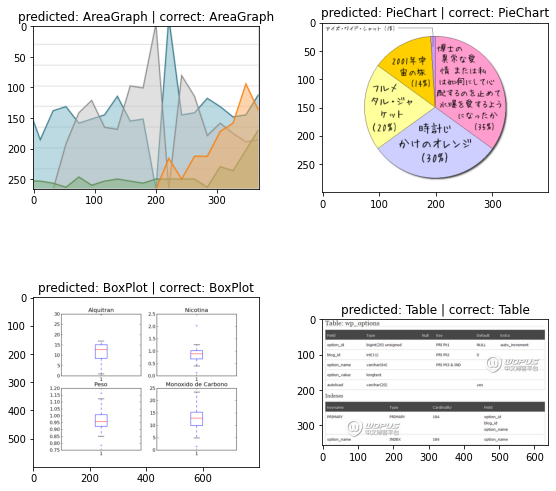

In [40]:
device = utils.get_device()

ALL_IMAGES = list(Path(test_folder).glob("**/*.*"))
# ALL_IMAGES = list(Path(val_folder).glob("**/*.*"))
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)

Additionally with SupervisedRunner, you can easily predict entire loader with only one method call. <br/>
The resulting object has shape = (number of elements in the loader, output shape from the model)

In [41]:
predictions = np.vstack(list(map(
    lambda x: x["logits"].cpu().numpy(), 
    runner.predict_loader(loader=loaders["valid"], resume=f"{logdir}/checkpoints/best.pth")
)))
print(predictions.shape)

print("logits: ", predictions[0])

probabilities = torch.softmax(torch.from_numpy(predictions[0]), dim=0)
print("probabilities: ", probabilities)

label = probabilities.argmax().item()
print(f"predicted: {class_names[label]}")

(1472, 21)
logits:  [-2.9290457  -2.8036058  -3.6083987  -3.972852   -1.5520025  -2.6687784
 -2.5908794   0.9377239  -1.9522628  -2.436198   -2.0312765  -0.91433513
 -2.2277772  -1.980589   -0.46420854 -1.5204594  10.616564   -2.0864723
 -1.3095537  -0.6012727  -2.8041797 ]
probabilities:  tensor([1.3096e-06, 1.4847e-06, 6.6392e-07, 4.6114e-07, 5.1903e-06, 1.6990e-06,
        1.8366e-06, 6.2585e-05, 3.4783e-06, 2.1438e-06, 3.2140e-06, 9.8204e-06,
        2.6406e-06, 3.3811e-06, 1.5403e-05, 5.3567e-06, 9.9985e-01, 3.0414e-06,
        6.6144e-06, 1.3431e-05, 1.4838e-06])
predicted: Signatures


## Model tracing

Catalyst allows you to use Runner to make [tracing](https://pytorch.org/docs/stable/jit.html) models.

> How to do this in the Config API, we wrote in [our blog (issue \#2)](https://github.com/catalyst-team/catalyst-info#catalyst-info-2-tracing-with-torchjit)

For this purpose it is necessary to pass in a method `trace ` model and a batch on which `predict_batch ` will be executed:

In [42]:
batch = next(iter(loaders["valid"]))
# saves to `logdir` and returns a `ScriptModule` class
runner.trace(model=model, batch=batch, logdir=logdir, fp16=is_fp16_used)

!ls {logdir}/trace/

traced-forward.pth


After this, you can easily load the model and predict anything!

In [43]:
from catalyst.dl.utils import trace

if is_fp16_used:
    model = trace.load_traced_model(
        f"{logdir}/trace/traced-forward-opt_O1.pth", 
        device="cuda", 
        opt_level="O1"
    )
else:
    model = trace.load_traced_model(
        f"{logdir}/trace/traced-forward.pth", 
        device="cpu"
    )

In [44]:
model_input = batch["features"].to("cuda" if is_fp16_used else "cpu")
model(model_input)

tensor([[-2.9290, -2.8036, -3.6084,  ..., -1.3096, -0.6013, -2.8042],
        [-2.8798, -1.9179, -2.5322,  ...,  9.9601, -1.7066, -3.8009],
        [-1.5407,  0.9988, -1.4578,  ..., -1.9367, -2.6212, 11.1090],
        ...,
        [-1.1137, -2.6462, -2.3159,  ..., -2.2171, -1.9752,  2.8337],
        [-1.7426, -2.0433, -2.4143,  ..., -1.0093, -2.1573, -1.9126],
        [-2.4345,  9.6483, -1.3964,  ..., -0.2455, -3.4884, -1.7248]])

### Advanced: Custom Callbacks

Let's count the number of predicted labels per class.

In [45]:
import collections

from catalyst.dl import Callback, CallbackOrder, IRunner


class CustomInferCallback(Callback):
  def __init__(self):
    super().__init__(CallbackOrder.Internal)
    self.class_counts = collections.defaultdict(lambda: 0)

  def on_loader_start(self, runner: IRunner):
    self.class_counts = collections.defaultdict(lambda: 0)

  def on_batch_end(self, runner: IRunner):
    # data from the Dataloader
    # features, targets = runner.input["features"], runner.input["targets"]
    logits = runner.output["logits"]

    labels = logits.argmax(axis=1)
    labels = labels.cpu().detach().numpy().tolist()
    for label in labels:
        self.class_counts[label] += 1


In [46]:
from collections import OrderedDict
from catalyst.dl.callbacks import CheckpointCallback

infer_loaders = {"infer": loaders["valid"]}
model = get_model(model_name, num_classes)

device = utils.get_device()
if is_fp16_used:
    fp16_params = dict(opt_level="O1") # params for FP16
else:
    fp16_params = None

runner = SupervisedRunner(device=device)
runner.infer(
    model=model,
    loaders=infer_loaders,
    callbacks=OrderedDict([
        ("loader", CheckpointCallback(resume=f"{logdir}/checkpoints/best.pth")),
        ("infer", CustomInferCallback())
    ]),
    fp16=fp16_params,
)

=> Loading checkpoint ./logs/classification/checkpoints/best.pth
loaded state checkpoint ./logs/classification/checkpoints/best.pth (global epoch 10, epoch 10, stage train)


In [54]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

class_counts = runner.runner._callbacks["infer"].class_counts
counts = [class_counts[x] for x in range(len(class_names))]

plt.figure(figsize=(20, 9))
x = np.arange(len(counts))
plt.bar(x + 0.5, height=counts)
plt.xticks(x - 0.3, class_names, rotation=65)
plt.show()

AttributeError: ignored

### Advanced: Training with Focal Loss and OneCycle

In the `catalyst.contrib` there are a large number of different additional criterions, models, layers etc

For example,

[catalyst.contrib.criterion](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.criterion.ce):
- HuberLoss
- CenterLoss
- FocalLossMultiClass
- DiceLoss / BCEDiceLoss
- IoULoss / BCEIoULoss
- LovaszLossBinary / LovaszLossMultiClass / LovaszLossMultiLabel
- WingLoss

Lr scheduler in [catalyst.contrib.schedulers](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.schedulers.base):
- OneCycleLRWithWarmup

Moreover, in [catalyst.contrib.models](https://catalyst-team.github.io/catalyst/api/contrib.html#models) you can find various models for segmentation:
- Unet / ResnetUnet
- Linknet / ResnetLinknet
- FPNUnet / ResnetFPNUnet
- PSPnet / ResnetPSPnet
- MobileUnet


Finally, several handwritten modules in [catalyst.contrib.modules](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.modules.common):
- Flatten
- TemporalAttentionPooling
- LamaPooling
- NoisyLinear
- GlobalAvgPool2d / GlobalMaxPool2d
- GlobalConcatPool2d / GlobalAttnPool2d

a bunch of others


But for now, let's take `FocalLoss` and `OneCycleLRWithWarmup` to play around.

In [55]:
from catalyst.contrib.nn import FocalLossMultiClass, OneCycleLRWithWarmup

logdir = "./logs/classification_tutorial_1"
num_epochs = 10

model = get_model(model_name, num_classes)

criterion = FocalLossMultiClass()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = OneCycleLRWithWarmup(
    optimizer, 
    num_steps=num_epochs, 
    lr_range=(0.001, 0.0001),
    warmup_steps=1
)

# FocalLoss expects one_hot for the input
# in our Reader function we have already created the conversion of targets in one_hot
# so, all we need - respecify the target key name
runner = SupervisedRunner(input_target_key="targets_one_hot")

In [56]:
runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    callbacks=[
        AccuracyCallback(num_classes=num_classes),
        AUCCallback(
            num_classes=num_classes,
            input_key="targets_one_hot",
            class_names=class_names
        ),
        F1ScoreCallback(
            input_key="targets_one_hot",
            activation="Softmax"
        )
    ],
    logdir=logdir,
    num_epochs=num_epochs,
    main_metric="auc/_mean",
    minimize_metric=False,
    fp16=fp16_params,
    verbose=True
)

1/10 * Epoch (train): 100% 57/57 [00:44<00:00,  1.27it/s, accuracy01=0.719, accuracy03=0.875, accuracy05=0.906, f1_score=0.412, loss=0.155, lr=1.000e-03, momentum=0.800]
1/10 * Epoch (valid): 100% 23/23 [00:12<00:00,  1.84it/s, accuracy01=0.578, accuracy03=0.750, accuracy05=0.812, f1_score=0.364, loss=0.319]
[2020-08-03 08:54:49,340] 
1/10 * Epoch 1 (_base): lr=0.0010 | momentum=0.8000
1/10 * Epoch 1 (train): accuracy01=0.6343 | accuracy03=0.7930 | accuracy05=0.8522 | auc/_mean=0.9044 | auc/class_AreaGraph=0.9388 | auc/class_BoxPlot=0.8660 | auc/class_BubbleChart=0.9022 | auc/class_FlowChart=0.9256 | auc/class_GeneralFigure=0.8361 | auc/class_GeneralPhoto=0.9409 | auc/class_HorizontalBarGraph=0.9082 | auc/class_LineGraph=0.8952 | auc/class_Logo=0.9151 | auc/class_Map=0.9497 | auc/class_NetworkDiagram=0.8356 | auc/class_ParetoChart=0.9031 | auc/class_PersonPhoto=0.9732 | auc/class_PieChart=0.8947 | auc/class_RadarPlot=0.9079 | auc/class_ScatterGraph=0.8702 | auc/class_Signatures=0.9461 

In [58]:
# it can take a while (colab issue)
utils.plot_metrics(
    logdir=logdir, 
    metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
)

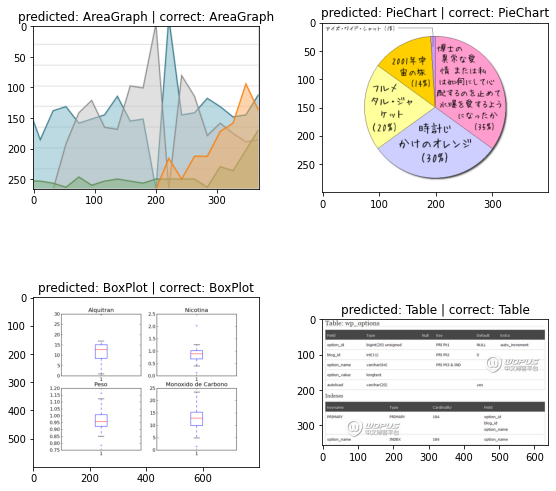

In [59]:
device = utils.get_device()
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)

### Advanced:  Balancing classes in the dataset

There are several useful data-sampler implementations in the `catalyst.data.sampler`. For example,
- `BalanceClassSampler` allows you to create stratified sampling on an unbalanced dataset. <br/> A strategy can be either downsampling, upsampling or some prespeficied number of samples per class. <br/> Very important feature for every classification problem.
- `MiniEpochSampler` allows you to split your "very large dataset" and sample some small portion of it every epoch. <br/> This is useful for those cases where you need to check valid metrics and save checkpoints more often. <br/> For example, your 1M images dataset can be sampled in 100k per epoch with all necessary metrics.

In [60]:
from catalyst.data import BalanceClassSampler

logdir = "./logs/classification_tutorial_2"
num_epochs = 10

labels = [x["label"] for x in train_data]
sampler = BalanceClassSampler(labels, mode="upsampling")

# let's re-create our loaders with BalanceClassSampler
loader = get_loaders(open_fn, train_data_transforms, valid_data_transforms, sampler=sampler)

model = get_model(model_name, num_classes)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = OneCycleLRWithWarmup(
    optimizer, 
    num_steps=num_epochs, 
    lr_range=(0.001, 0.0001),
    warmup_steps=1
)

runner = SupervisedRunner()

In [61]:
runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    callbacks=[
        AccuracyCallback(num_classes=num_classes),
        AUCCallback(
            num_classes=num_classes,
            input_key="targets_one_hot",
            class_names=class_names
        ),
        F1ScoreCallback(
            input_key="targets_one_hot",
            activation="Softmax"
        )
    ],
    logdir=logdir,
    num_epochs=num_epochs,
    main_metric="auc/_mean",
    minimize_metric=False,
    fp16=fp16_params,
    verbose=True
)

1/10 * Epoch (train): 100% 57/57 [00:40<00:00,  1.41it/s, accuracy01=0.672, accuracy03=0.906, accuracy05=0.922, f1_score=0.583, loss=0.936, lr=1.000e-03, momentum=0.800]
1/10 * Epoch (valid): 100% 23/23 [00:11<00:00,  2.03it/s, accuracy01=0.578, accuracy03=0.828, accuracy05=0.906, f1_score=0.556, loss=1.698]
[2020-08-03 09:05:27,702] 
1/10 * Epoch 1 (_base): lr=0.0010 | momentum=0.8000
1/10 * Epoch 1 (train): accuracy01=0.7039 | accuracy03=0.8775 | accuracy05=0.9246 | auc/_mean=0.9415 | auc/class_AreaGraph=0.9504 | auc/class_BoxPlot=0.9412 | auc/class_BubbleChart=0.9714 | auc/class_FlowChart=0.9447 | auc/class_GeneralFigure=0.8279 | auc/class_GeneralPhoto=0.9660 | auc/class_HorizontalBarGraph=0.9675 | auc/class_LineGraph=0.9377 | auc/class_Logo=0.9662 | auc/class_Map=0.9492 | auc/class_NetworkDiagram=0.9128 | auc/class_ParetoChart=0.9439 | auc/class_PersonPhoto=0.9918 | auc/class_PieChart=0.9431 | auc/class_RadarPlot=0.9264 | auc/class_ScatterGraph=0.9194 | auc/class_Signatures=0.9512 

In [62]:
# it can take a while (colab issue)
utils.plot_metrics(
    logdir=logdir, 
    metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
)

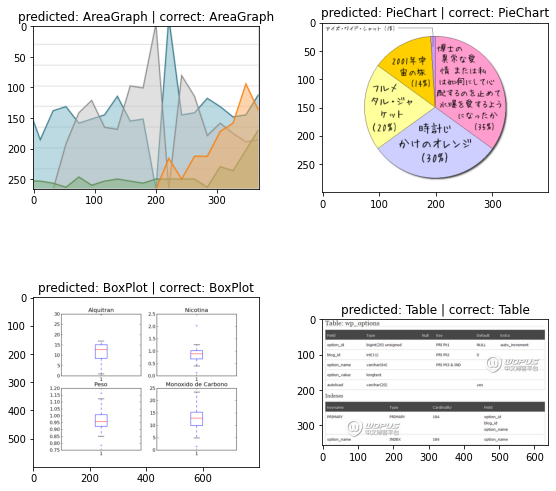

In [63]:
device = utils.get_device()
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)

## Prediction

Save the trained model

In [64]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [65]:
!cp ./logs/classification/trace/traced-forward.pth /content/drive/My\ Drive/traced-forward.pth 

Load the trained model

In [66]:
model_path = "./traced-forward.pth"
!cp /content/drive/My\ Drive/traced-forward.pth {model_path}
!ls

drive  input  logs  sample_data  traced-forward.pth


Class to predict with the code of the catalyst.

In [67]:
import albumentations as albu
from albumentations.pytorch import ToTensor
from catalyst.dl.utils import trace
from torch.nn.functional import softmax

import os
import torch
import catalyst
from pathlib import Path
from catalyst.dl import utils

class FigurePrediction_Catalyst:

  def __init__(self, model_path:str):

    self.transforms = self.compose([self.pre_transforms(), self.post_transforms()])

    # Load the model
    self.device = utils.get_device()
    self.model = trace.load_traced_model(
        str(model_path), 
        device=self.device
    )


  def predict(self, image_filepaths:list):

    images = []
    for image_filepath in image_filepaths:
      # Load the image to imread
      img = imread(str(image_filepath))
      images.append(img)

    # Predict 
    with torch.no_grad():
      tensor_ = torch.stack(
          [self.transforms(image=img)["image"]
           for img in images]
          ).to(self.device)

      logits = self.model(tensor_)
      probabilities = softmax(logits, dim=1)
      predictions = probabilities.argmax(dim=1)


    images_predicted_classes = [
        (x, image)
        for x, image in zip(predictions, image_filepaths)
    ]
    return images_predicted_classes
    

  #
  # TRANSFORMATION FUNCTIONS
  #
    
  BORDER_CONSTANT = 0
  # BORDER_REFLECT = 2

  @staticmethod
  def pre_transforms(image_size=224):
      # Convert the image to a square of size image_size x image_size
      # (keeping aspect ratio)
      result = [
          albu.LongestMaxSize(max_size=image_size),
          albu.PadIfNeeded(image_size, image_size, border_mode=FigurePrediction_Catalyst.BORDER_CONSTANT)
      ]
      
      return result

  @staticmethod
  def post_transforms():
      # we use ImageNet image normalization
      # and convert it to torch.Tensor
      return [albu.Normalize(), ToTensor()]

  @staticmethod
  def compose(transforms_to_compose):
      # combine all augmentations into one single pipeline
      result = albu.Compose([
        item for sublist in transforms_to_compose for item in sublist
      ])
      return result

PieChart


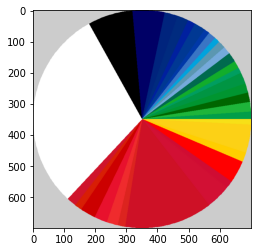

Logo


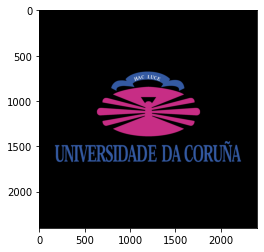

LineGraph


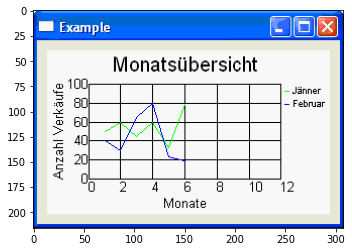

NetworkDiagram


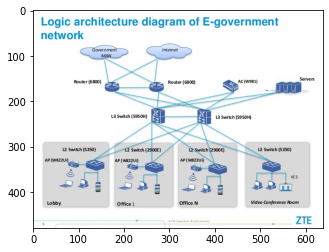

AreaGraph


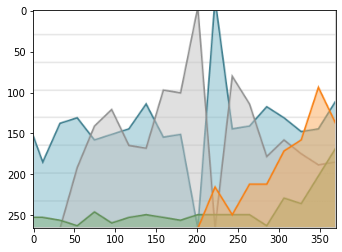

BoxPlot


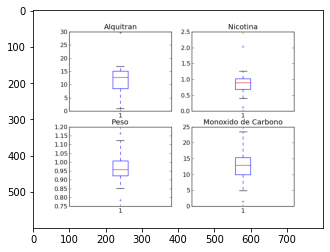

GeneralFigure


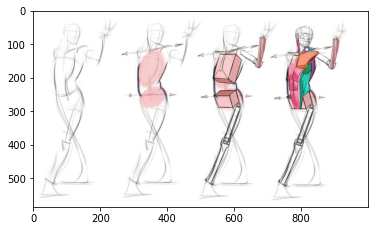

ParetoChart


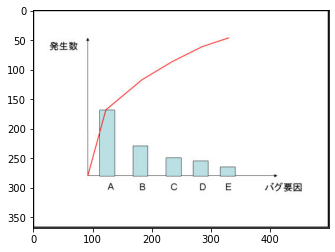

VerticalBarGraph


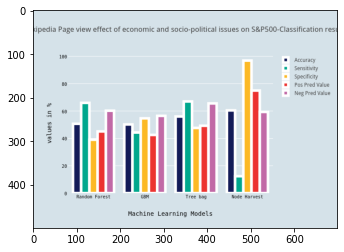

AreaGraph


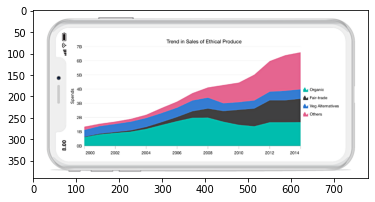

Map


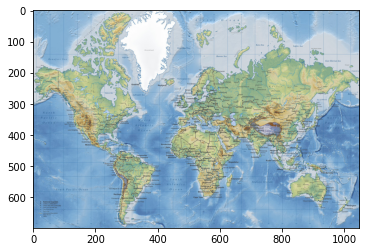

BubbleChart


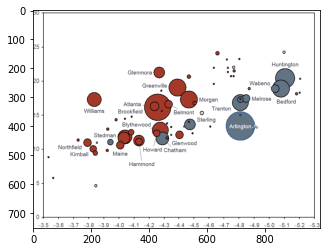

FlowChart


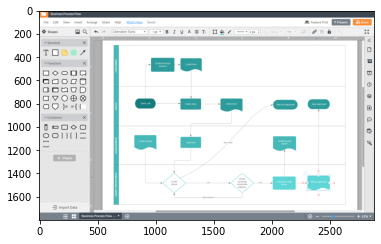

BoxPlot


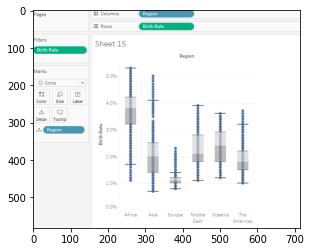

FlowChart


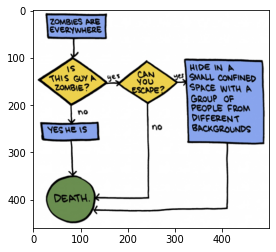

VennDiagram


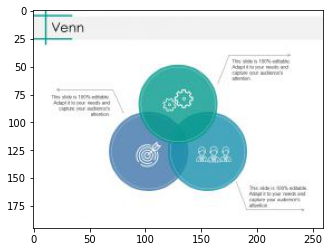

ParetoChart


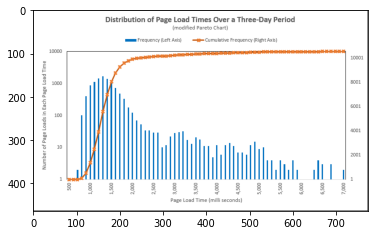

ScatterGraph


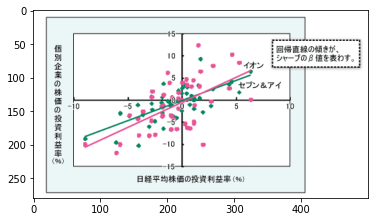

Table


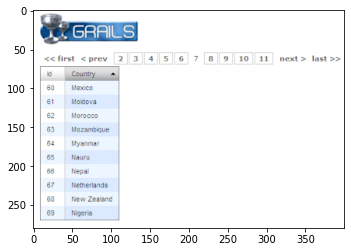

ParetoChart


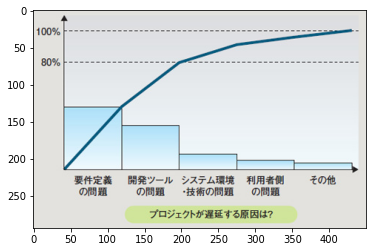

BubbleChart


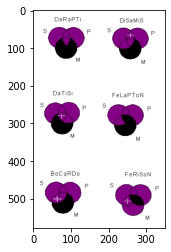

PersonPhoto


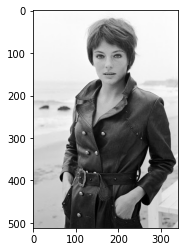

RadarPlot


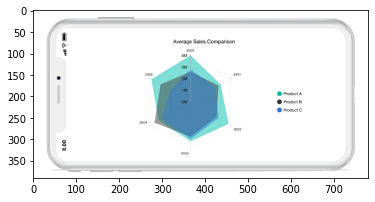

PersonPhoto


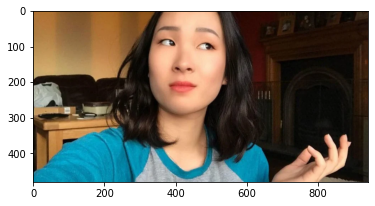

Signatures


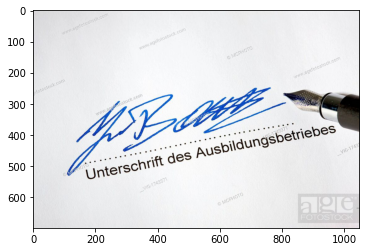

GeneralPhoto


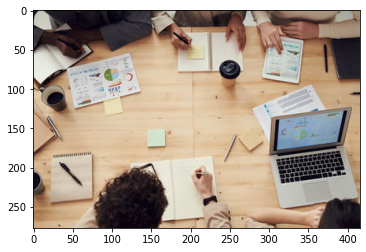

TreeDiagram


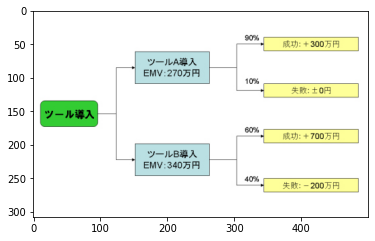

TreeDiagram


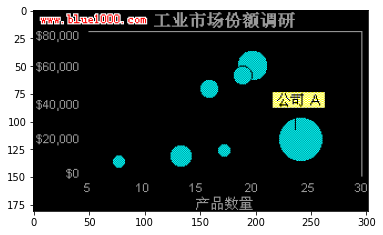

HorizontalBarGraph


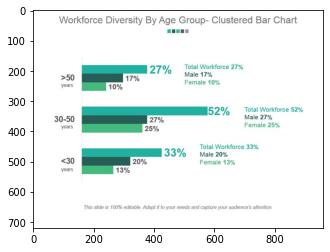

Signatures


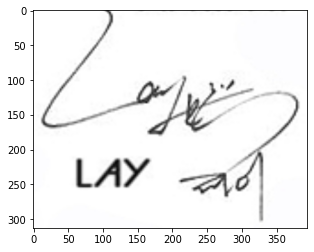

Signatures


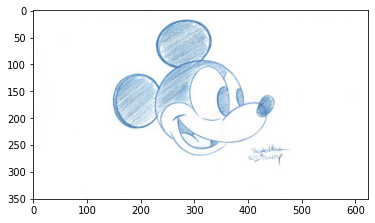

ScatterGraph


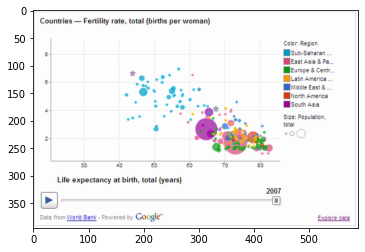

Logo


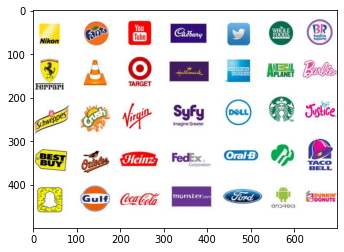

PieChart


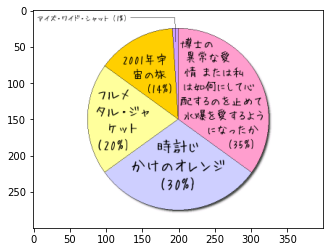

PieChart


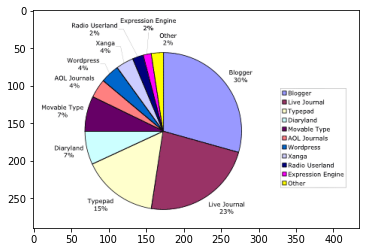

Map


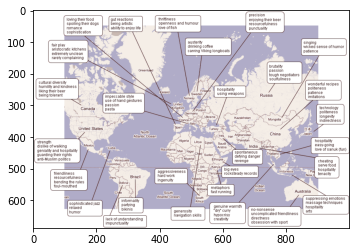

LineGraph


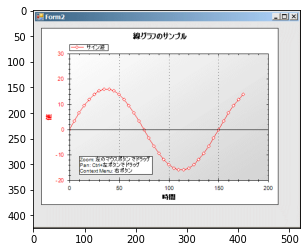

VerticalBarGraph


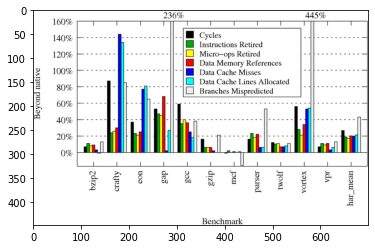

NetworkDiagram


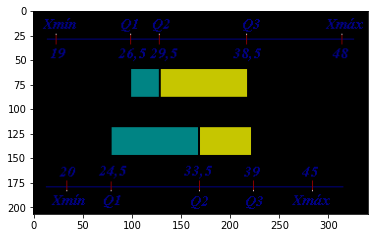

FlowChart


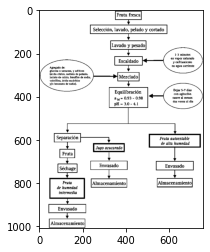

LineGraph


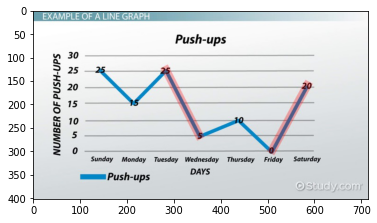

Table


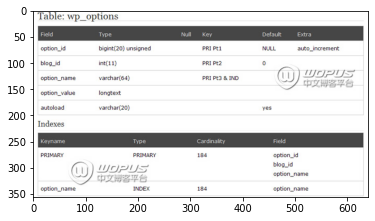

VennDiagram


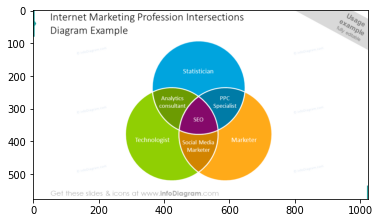

Map


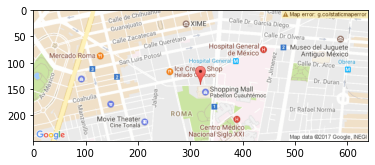

VerticalBarGraph


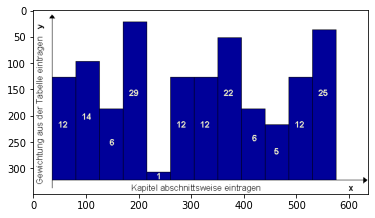

NetworkDiagram


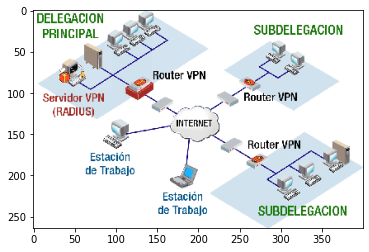

GeneralPhoto


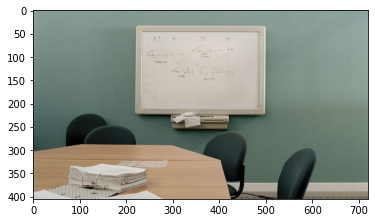

RadarPlot


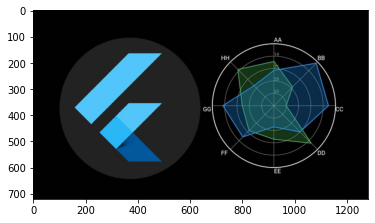

VennDiagram


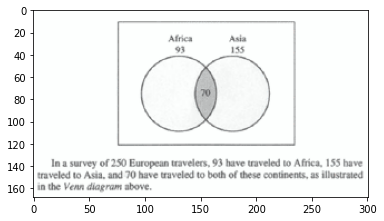

Map


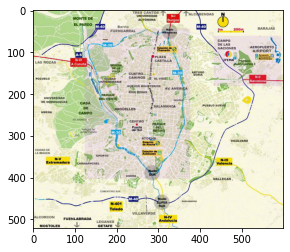

GeneralFigure


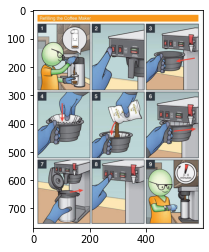

FlowChart


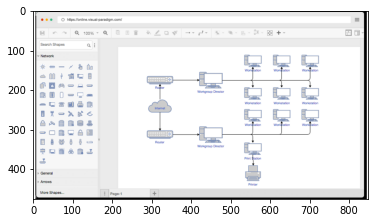

GeneralPhoto


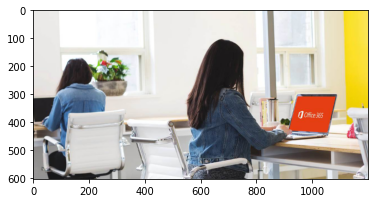

PersonPhoto


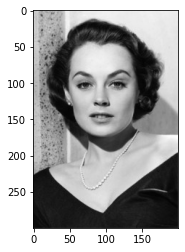

BubbleChart


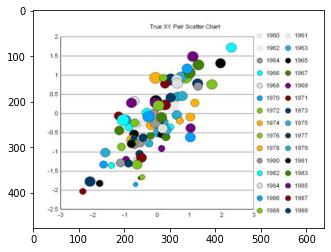

VerticalBarGraph


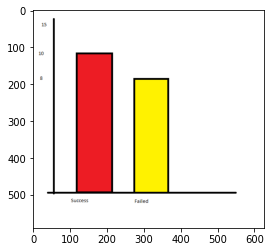

TreeDiagram


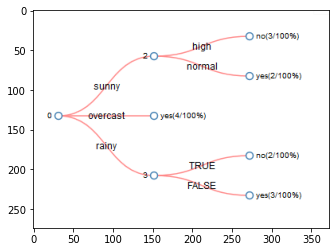

Logo


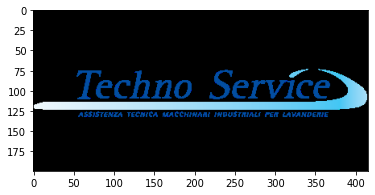

Signatures


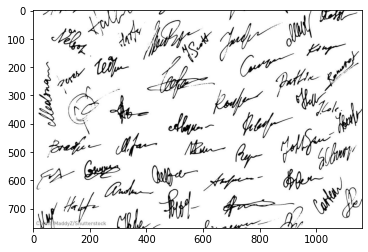

RadarPlot


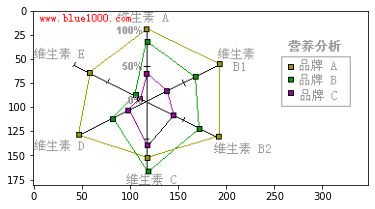

HorizontalBarGraph


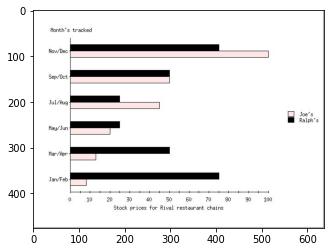

ScatterGraph


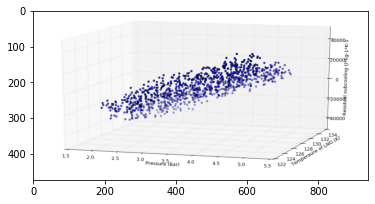

In [70]:
from catalyst.utils import imread
import matplotlib.pyplot as plt

predicter = FigurePrediction_Catalyst(model_path=model_path)

test_folder = "/content/input/dataset/test_raw/"
test_images = list(Path(test_folder).glob("*.*"))
output = predicter.predict(test_images)

classes = ['AreaGraph', 'BoxPlot', 'BubbleChart', 'FlowChart', 'GeneralFigure',
 'GeneralPhoto', 'HorizontalBarGraph', 'LineGraph', 'Logo','Map', 'NetworkDiagram',
 'ParetoChart', 'PersonPhoto', 'PieChart', 'RadarPlot' ,'ScatterGraph',
 'Signatures', 'Table', 'TreeDiagram', 'VennDiagram', 'VerticalBarGraph']


# Show result
for (pred, img_path) in output:
  print(classes[pred])
  img = imread(img_path)
  plt.imshow(img)
  plt.show()

